# Juliaでオーディオプログラミング入門
このNotebookは [Wanoグループ Advent Calendar 2019 Advent Calendar 2019](https://qiita.com/advent-calendar/2019/wano-group) の8日目の記事です。

## 0. はじめに
~~〆切当日になってもネタが思い浮かばなかったので、~~ 今年も趣味のオーディオプログラミングの話をします。  
ちなみに、去年は、[Faust Lang.とWeb Audio APIによるオーディオプログラミング入門](https://qiita.com/tdaiki-wano/items/06656a04a82963e22129)について取り扱いました。  
今年は、Julia Lang.とJupyaterLabを組み合わせた、オーディオデータの取り扱い（生成・再生・加工・可視化）について触れていきます。  

## 1. Julia Languageの紹介
[Julia Language](https://julialang.org/)は2018年にVersion 1.0がリリースされた比較的新しい汎用プログラミング言語です。  
[動的型付き言語にあるまじき実行速度を叩きだせる点](https://julialang.org/benchmarks/)が大きな魅力ですが、そのシンタックスも非常に魅力的な言語です。  
ちょっとだけ、Juliaの魅力を紹介しましょう。以下のコードを見てください。

In [1]:
# 回転行列
function rot(θ::AbstractFloat)
    [
        cos(θ) -sin(θ)
        sin(θ)  cos(θ)
    ]
end

# r₀(1, 0)を+90度回転させる
@show r₀ = [1., 0.]
@show r₁ = rot(0.5π) * r₀

r₀ = [1.0, 0.0] = [1.0, 0.0]
r₁ = rot(0.5π) * r₀ = [6.123233995736766e-17, 1.0]


2-element Array{Float64,1}:
 6.123233995736766e-17
 1.0                  

たったこれだけのコードからでも、他のプログラミング言語にはないユニークかつ魅力的な特徴がいくつか見てとれます。
* ベクトルや行列の記述が簡単（見た目もかなり直感的！）
* 特別な記述なしに行列の四則演算ができる
* 動的型付き言語でありながら、必要な部分で型システムの恩恵を受けられる
* ASCII文字以外でも変数に使える
* etc...  
  
同等の記述をここまでシンプルかつ直感的な形で表現できる汎用プログラミング言語は、なかなか無いのでないでしょうか。  
また、見ての通りJupyter上で実行できるので、データの可視化周りのライブラリも充実しています。  
例えば、グラフ描画用のライブラリ([Plots.jl](http://docs.juliaplots.org/latest/))を使えば、以下のようにさくっとNotebook上でグラフを描画できます。

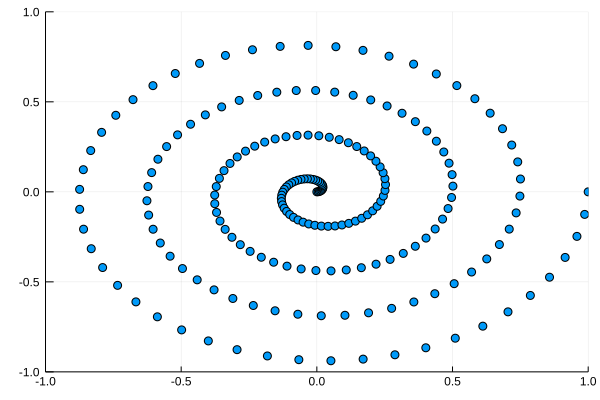

In [2]:
using Plots
gr()

θ = LinRange(0, 8π, 200)
A = LinRange(0, 1, 200)
r = hcat((A .* map(x -> rot(x) * r₀, θ))...)
plot(r[1, :], r[2, :], st=:scatter, legend=false, xlim=(-1, 1), ylim=(-1, 1))

楽しい！！ ✌('ω'✌ )三✌('ω')✌三( ✌'ω')✌

# 1. Juliaで生成した波形データの音を鳴らす
オーディオプログラミングの初手といえば、Hello, sineこと440 Hzのサイン波を鳴らすことでしょうか (※要出典)  
以下は、440 HzのSineを生成・再生するコードスニペットです。

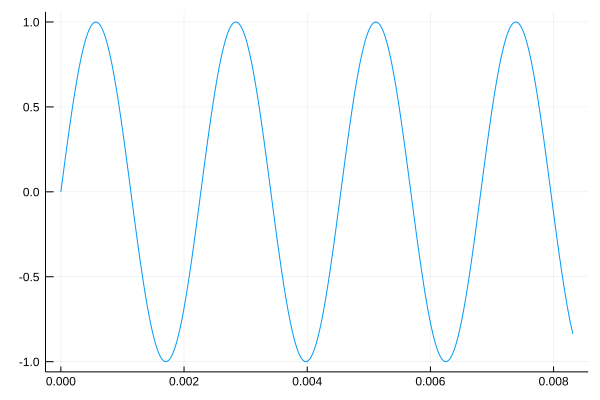

In [3]:
fs = 48000.0 # sampling rate
f = 440.0 # 440 Hz
sec = 10 # 10 sec分の長さのデータを生成 
n = [i for i in 0:sec*fs]
y = sin.(2π*f*n/fs)
plot(n[1:400] / fs, y[1:400], legend=false)

[SampledSignals.jl](https://github.com/JuliaAudio/SampledSignals.jl)を使えばNotebook上で音を聞くことができます。

In [17]:
using SampledSignals

# mono
println("音量注意")
SampleBuf(0.4y, fs)

音量注意


480001-frame, 1-channel SampleBuf{Float64, 1}
10.000020833333334s sampled at 48000.0Hz
▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇

In [13]:
# stereo [波形データ * channel]のMatrixを渡す
amplitude = collect(LinRange(0, 1.0, length(y)))
Y = [amplitude .* y reverse(amplitude) .* y]
SampleBuf(0.4Y, fs)

480001-frame, 2-channel SampleBuf{Float64, 2}
10.000020833333334s sampled at 48000.0Hz
▂▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇
▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▂

ただのデータ列だったものが音として認識できるとテンション上がりますね。  
楽しい！！ ✌('ω'✌ )三✌('ω')✌三( ✌'ω')✌

## 2. オーディオデータを読み込んで再生する
[LibSndFile.jl](https://github.com/JuliaAudio/LibSndFile.jl)を使います

In [6]:
using FileIO: load
import LibSndFile

audio = load("./AudioSample.wav")

480000-frame, 2-channel SampleBuf{FixedPointNumbers.Fixed{Int16,15}, 2}
10.0s sampled at 48000.0Hz
▆▃▃▂▆▄▄▂▆▃▆▃▆▄▄▂▆▃▃▂▆▄▄▂▆▃▆▃▆▄▆▃▆▃▃▂▆▄▄▂▆▃▆▃▆▄▄▂▆▃▃▂▆▄▄▂▆▃▆▃▆▄▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
▆▃▃▁▆▄▄▂▆▃▆▃▆▄▄▂▆▃▃▂▆▄▃▂▆▃▆▃▆▄▆▃▆▃▃▁▆▄▄▂▆▃▆▃▆▄▄▂▆▃▃▂▆▄▃▂▆▃▆▃▆▄▆▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁

In [11]:
wavedata = audio.data
x = 0:size(wavedata)[1]-1
left = plot(x/audio.samplerate, wavedata[:, 1], title="Left", legend=false, ylims=(-1, 1))
right = plot(x/audio.samplerate, wavedata[:, 2], title="Right", legend=false, ylims=(-1, 1))
plot(left, right, layout=(2,1))

## 3. 読み込んだオーディオデータを加工する
せっかくなので、ちょっと信号処理っぽいこともしてみましょう。  
読み込んだドラムループに[Moog等のシンセサイザーで利用されているラダーフィルタ](https://quod.lib.umich.edu/i/icmc/bbp2372.1996.123/1/--analyzing-the-moog-vcf-for-digital-implementation?rgn=full+text;view=image;q1=stilson)を適用してみます。

In [18]:
mutable struct LadderLPF
    z::Float64
    x::Vector{Float64}
    y::Vector{Float64}
end

LadderLPF() = LadderLPF(0., zeros(Float64, 4), zeros(Float64, 4))

function process(f::LadderLPF, x₀::Float64, fc, k, fs)
    ωc = 2π*fc
    a = (ωc + 1.3fs)
    b₀ = ωc/a
    b₁ = 0.3ωc/a
    a₁ = (0.3ωc - 1.3fs)/a
    
    x = x₀ - f.z
    for i=1:4
        y = b₀*x + b₁*f.x[i] - a₁*f.y[i]
        f.x[i] = x
        f.y[i] = y
        x = y
    end

    f.z = k*x
    
    return x
end

l = convert(Vector{Float64}, wavedata[:, 1])
f = LadderLPF()
k = 1.5
fs = audio.samplerate
fc = collect(LinRange(500.0, 20.0*10^3, length(l)))
for i = 1:length(l)
    l[i] = process(f, l[i], fc[i], k, fs)
end

r = convert(Vector{Float64}, wavedata[:, 2])
f = LadderLPF()
for i = 1:length(fc)
    r[i] = process(f, r[i], fc[i], k, fs)
end

SampleBuf([l r], fs)

480000-frame, 2-channel SampleBuf{Float64, 2}
10.0s sampled at 48000.0Hz
▅▂▁▁▅▂▂▁▅▂▅▂▅▃▂▁▅▂▂▁▅▃▂▁▅▂▅▂▅▃▅▂▅▂▂▁▆▃▃▁▅▂▅▂▅▃▃▁▅▂▃▁▅▃▃▁▅▃▅▂▅▃▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
▅▂▁▁▅▂▂▁▅▂▅▂▅▃▂▁▅▂▂▁▅▃▃▁▅▂▅▂▅▃▅▂▅▂▂▁▆▃▃▁▅▂▅▂▅▃▃▁▅▂▂▁▅▃▃▁▅▃▅▂▅▃▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁

## 3. おわりに
他にも、Juliaによるgifアニメーションの作成やオーディオ線形システムの特性評価についても書きたかったのですが、時間が無いのでこのあたりで終わります。  
本稿で最小の労力で、豊かな表現を引き出せるJulia言語の魅力が少しでも伝われば幸いです。  

In [14]:
println("終わりだよ～(o・∇・o) ")

終わりだよ～(o・∇・o) 
